In [2]:
import numpy as np, random, math, base64
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display
from io import BytesIO
from pathlib import Path

root = Path("/Users/aleksandrrazin/work/research/3d/HumanML3D/HumanML3D")

# Only keep ids that exist in both folders
motion_ids = {p.stem for p in (root / "new_joints").glob("*.npy")}
text_ids   = {p.stem for p in (root / "texts").glob("*.txt")}
valid_ids  = sorted(motion_ids & text_ids)
print(f"Found {len(valid_ids)} ids with motion+text")

# Kinematic chain and colors (HumanML3D, 22 joints)
t2m_kinematic_chain = [
    [0, 1, 4, 7, 10],
    [0, 2, 5, 8, 11],
    [0, 3, 6, 9, 12, 15],
    [9, 13, 16, 18, 20],
    [9, 14, 17, 19, 21],
]
grid_colors = [
    "#DD5A37", "#D69E00", "#B75A39", "#DD5A37", "#D69E00",
    "#FF6D00", "#FF6D00", "#FF6D00", "#FF6D00", "#FF6D00",
    "#DDB50E", "#DDB50E", "#DDB50E", "#DDB50E", "#DDB50E",
]

def load_pair(motion_id):
    text_path = root / "texts" / f"{motion_id}.txt"
    motion_path = root / "new_joints" / f"{motion_id}.npy"
    captions = [ln.split("#")[0].strip() for ln in text_path.read_text().splitlines() if ln]
    joints = np.load(motion_path)  # (T,22,3)
    return captions, joints

def animate_motion(motion_id, joints, caption, radius=1.5):
    centered = joints.copy()
    root_pos = centered[:, 0, :]
    centered[:, :, 0] -= root_pos[:, None, 0]
    centered[:, :, 2] -= root_pos[:, None, 2]

    fig = plt.figure(figsize=(5, 5))
    ax = fig.add_subplot(111, projection="3d")

    def update(frame):
        ax.clear()
        ax.set_xlim3d([-radius, radius]); ax.set_ylim3d([-radius, radius]); ax.set_zlim3d([0, radius * 2])
        ax.set_xlabel("X (Side)"); ax.set_ylabel("Z (Forward)"); ax.set_zlabel("Y (Up)")
        curr = centered[frame]
        for chain in t2m_kinematic_chain:
            x = curr[chain, 0]; y = curr[chain, 2]; z = curr[chain, 1]
            ax.plot(x, y, z, linewidth=2, marker="o", markersize=4)
        ax.view_init(elev=20, azim=-45)
        ax.set_title(f"{motion_id} — {caption}", fontsize=9)

    return FuncAnimation(fig, update, frames=len(centered), interval=50)

def make_grid_image(joints, cols=8, max_frames=32):
    # Downsample to keep grid compact
    step = max(1, len(joints) // max_frames)
    poses = joints[::step]
    poses = poses[:, :22, :]  # ensure 22 joints

    rows = max(1, math.ceil(len(poses) / cols))
    fig = plt.figure(figsize=(cols * 2.2, rows * 2.2))
    for idx in range(rows * cols):
        ax = fig.add_subplot(rows, cols, idx + 1, projection="3d")
        if idx < len(poses):
            pose = poses[idx].copy()
            pose[:, 0] -= pose[0, 0]; pose[:, 2] -= pose[0, 2]
            ax.view_init(elev=120, azim=-90)
            ax.set_axis_off()
            for chain, color in zip(t2m_kinematic_chain, grid_colors):
                ax.plot(pose[chain, 0], pose[chain, 1], pose[chain, 2], color=color, linewidth=2)
            ax.scatter(pose[:, 0], pose[:, 1], pose[:, 2], s=6, c="black")
            ax.set_title(f"t={idx*step}", fontsize=7)
        else:
            ax.set_axis_off()
    plt.tight_layout()
    buf = BytesIO()
    fig.savefig(buf, format="png", dpi=120, bbox_inches="tight")
    plt.close(fig)
    b64 = base64.b64encode(buf.getvalue()).decode("ascii")
    return f"data:image/png;base64,{b64}"

Found 2937 ids with motion+text



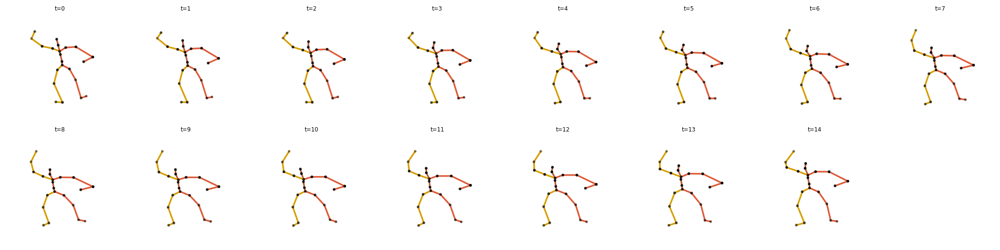


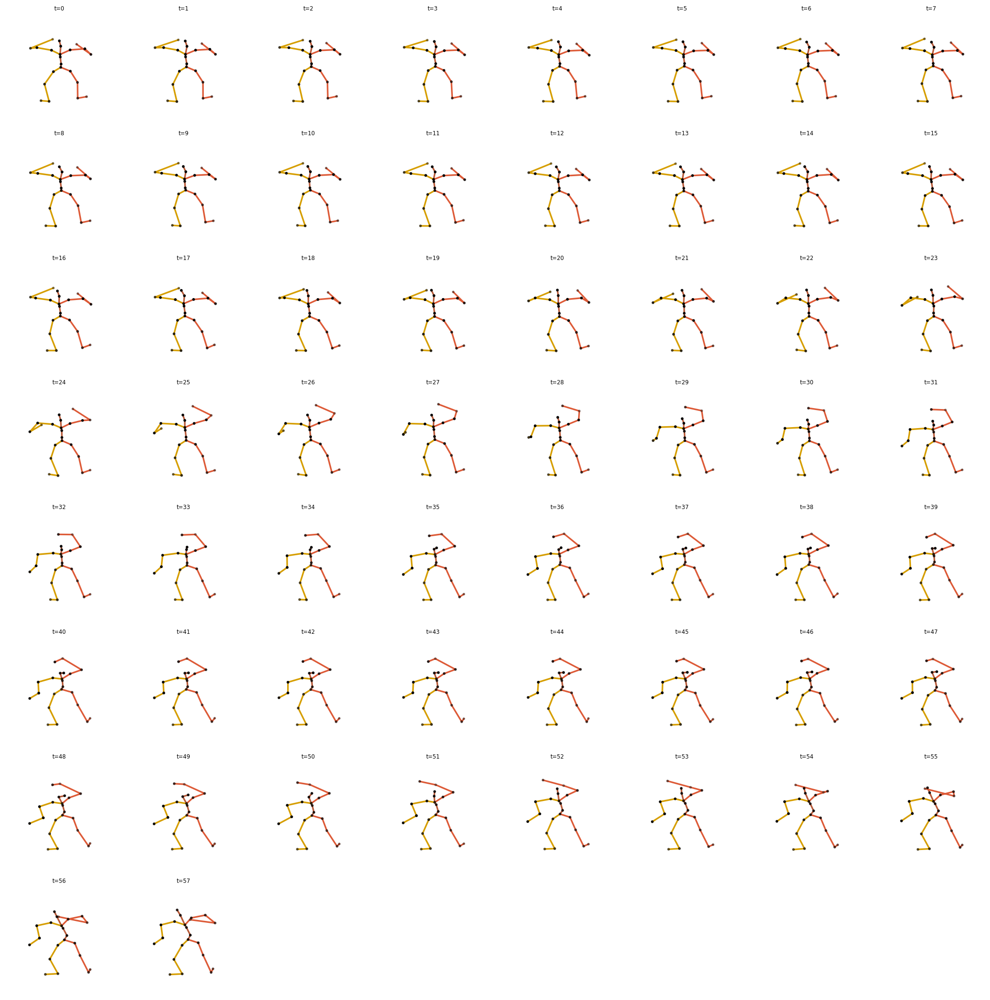


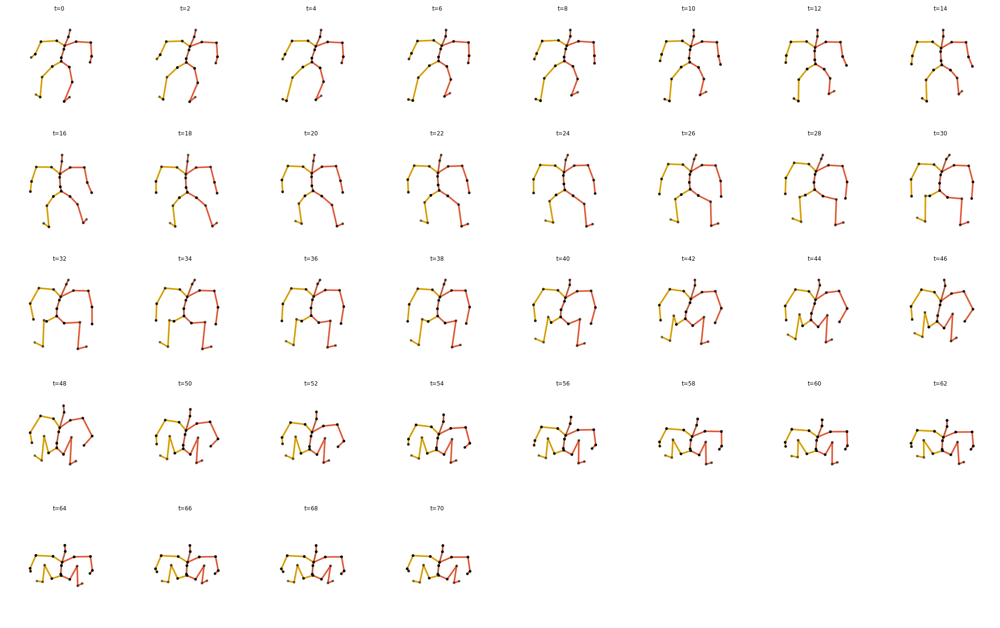


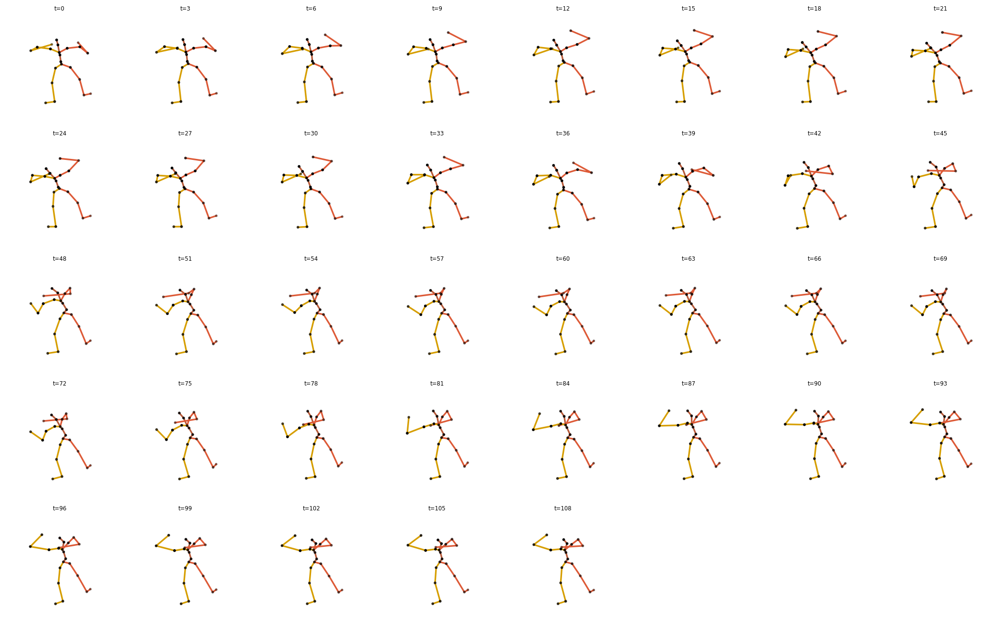


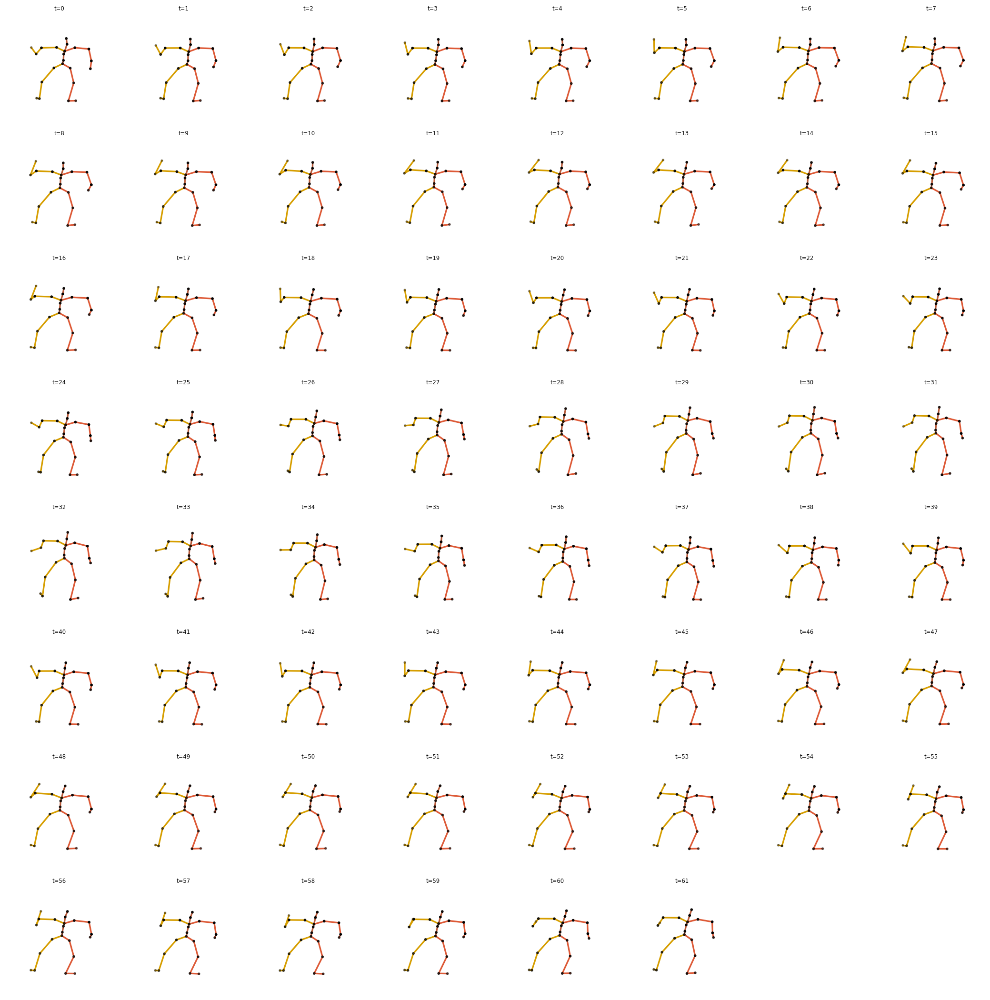

In [3]:
# Sample and display
for motion_id in random.sample(valid_ids, min(5, len(valid_ids))):
    captions, joints = load_pair(motion_id)
    caption = captions[0] if captions else "(no caption)"
    ani = animate_motion(motion_id, joints, caption)
    grid_src = make_grid_image(joints)

    html = f"""
    <div style="display:flex; gap:12px; align-items:flex-start; margin-bottom:20px;">
      <div>{ani.to_jshtml()}</div>
      <div>
        <p style="margin:0 0 6px 0; font-weight:bold;">{motion_id} — {caption}</p>
        <img src="{grid_src}" style="max-width:520px; height:auto; border:1px solid #ccc;"/>
      </div>
    </div>
    """
    display(HTML(html))
    plt.close('all')

In [4]:
import shutil
from pathlib import Path
import numpy as np

def copy_sample_trim(sample_id: str, dataset_root: str, dest_root: str):
    """
    Copy text and a trimmed motion file (first and last frames only).
    sample_id: e.g., "000001" or "M004551"
    dataset_root: folder containing new_joints/ and texts/
    dest_root: where you want copies placed (creates dest_root/sample_id)
    """
    ds = Path(dataset_root)
    dst = Path(dest_root) / sample_id
    dst.mkdir(parents=True, exist_ok=True)

    src_motion = ds / "new_joints" / f"{sample_id}.npy"
    src_text   = ds / "texts" / f"{sample_id}.txt"
    if not src_motion.exists():
        raise FileNotFoundError(f"Missing motion file: {src_motion}")
    if not src_text.exists():
        raise FileNotFoundError(f"Missing text file: {src_text}")

    # Copy text as-is
    shutil.copy2(src_text, dst / src_text.name)

    # Trim motion to first/last frame
    motion = np.load(src_motion)  # shape: (T, J, 3)
    if len(motion) == 0:
        raise ValueError(f"Motion file is empty: {src_motion}")
    trimmed = motion[[0]] if len(motion) == 1 else motion[[0, -1]]
    np.save(dst / src_motion.name, trimmed)
    print(f"Saved trimmed motion (shape {trimmed.shape}) and text to {dst}")

# Example usage:
copy_sample_trim("M004590",
            "/Users/aleksandrrazin/work/research/3d/HumanML3D/HumanML3D",
            "/Users/aleksandrrazin/work/research/3d/motion-latent-diffusion/demo")

Saved trimmed motion (shape (2, 22, 3)) and text to /Users/aleksandrrazin/work/research/3d/motion-latent-diffusion/demo/M004590



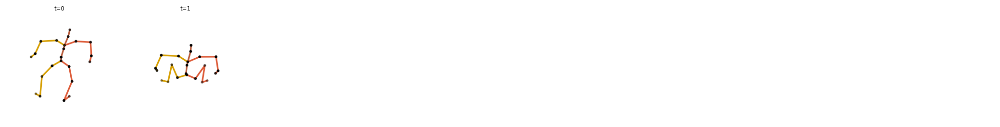

In [5]:
import numpy as np, math, base64
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display
from io import BytesIO
from pathlib import Path

# Set your files here
motion_path = Path("/Users/aleksandrrazin/work/research/3d/motion-latent-diffusion/results/mld/mld_controlnet_train_exp6/samples_2025-12-30-10-52-53/Example_196_batch0_0.npy")
text_path   = Path("/Users/aleksandrrazin/work/research/3d/motion-latent-diffusion/results/mld/mld_controlnet_train_exp6/samples_2025-12-30-10-52-53/Example_196_batch0_0.txt")

motion_path = Path("/Users/aleksandrrazin/work/research/3d/motion-latent-diffusion/demo/M004590/M004590.npy")
text_path   = Path("/Users/aleksandrrazin/work/research/3d/motion-latent-diffusion/demo/M004590/M004590.txt")


# Kinematic chain and colors
t2m_kinematic_chain = [
    [0, 1, 4, 7, 10],
    [0, 2, 5, 8, 11],
    [0, 3, 6, 9, 12, 15],
    [9, 13, 16, 18, 20],
    [9, 14, 17, 19, 21],
]
grid_colors = [
    "#DD5A37", "#D69E00", "#B75A39", "#DD5A37", "#D69E00",
    "#FF6D00", "#FF6D00", "#FF6D00", "#FF6D00", "#FF6D00",
    "#DDB50E", "#DDB50E", "#DDB50E", "#DDB50E", "#DDB50E",
]

# Load data
captions = [ln.split("#")[0].strip() for ln in text_path.read_text().splitlines() if ln]
caption = captions[0] if captions else "(no caption)"
joints = np.load(motion_path)  # (T,22,3)

# Center for viewing
centered = joints.copy()
root_pos = centered[:, 0, :]
centered[:, :, 0] -= root_pos[:, None, 0]
centered[:, :, 2] -= root_pos[:, None, 2]

def animate_motion(joints, caption, radius=1.5):
    fig = plt.figure(figsize=(5, 5))
    ax = fig.add_subplot(111, projection="3d")

    def update(frame):
        ax.clear()
        ax.set_xlim3d([-radius, radius]); ax.set_ylim3d([-radius, radius]); ax.set_zlim3d([0, radius * 2])
        ax.set_xlabel("X (Side)"); ax.set_ylabel("Z (Forward)"); ax.set_zlabel("Y (Up)")
        curr = joints[frame]
        for chain in t2m_kinematic_chain:
            x = curr[chain, 0]; y = curr[chain, 2]; z = curr[chain, 1]
            ax.plot(x, y, z, linewidth=2, marker="o", markersize=4)
        ax.view_init(elev=20, azim=-45)
        ax.set_title(caption, fontsize=9)

    return FuncAnimation(fig, update, frames=len(joints), interval=50)

def make_grid_image(joints, cols=8, max_frames=32):
    step = max(1, len(joints) // max_frames)
    poses = joints[::step][:, :22, :]
    rows = max(1, math.ceil(len(poses) / cols))
    fig = plt.figure(figsize=(cols * 2.2, rows * 2.2))
    for idx in range(rows * cols):
        ax = fig.add_subplot(rows, cols, idx + 1, projection="3d")
        if idx < len(poses):
            pose = poses[idx].copy()
            pose[:, 0] -= pose[0, 0]; pose[:, 2] -= pose[0, 2]
            ax.view_init(elev=120, azim=-90)
            ax.set_axis_off()
            for chain, color in zip(t2m_kinematic_chain, grid_colors):
                ax.plot(pose[chain, 0], pose[chain, 1], pose[chain, 2], color=color, linewidth=2)
            ax.scatter(pose[:, 0], pose[:, 1], pose[:, 2], s=6, c="black")
            ax.set_title(f"t={idx*step}", fontsize=7)
        else:
            ax.set_axis_off()
    plt.tight_layout()
    buf = BytesIO()
    fig.savefig(buf, format="png", dpi=120, bbox_inches="tight")
    plt.close(fig)
    return base64.b64encode(buf.getvalue()).decode("ascii")

ani = animate_motion(centered, caption)
grid_src = make_grid_image(joints)

html = f"""
<div style="display:flex; gap:12px; align-items:flex-start; margin-bottom:20px;">
  <div>{ani.to_jshtml()}</div>
  <div>
    <p style="margin:0 0 6px 0; font-weight:bold;">{motion_path.stem} — {caption}</p>
    <img src="data:image/png;base64,{grid_src}" style="max-width:520px; height:auto; border:1px solid #ccc;"/>
  </div>
</div>
"""
display(HTML(html))
plt.close('all')
